In [35]:
%matplotlib inline
%env CUDA_VISIBLE_DEVICES = 1

env: CUDA_VISIBLE_DEVICES=1


In [271]:
%run mylibrary.ipynb
%run MiniPINN.ipynb

In [198]:
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import os
import tensorflow as tf
import math
import random
from ast import literal_eval

In [273]:
geometry = pd.read_csv('../tools/AA_geometry.tsv', header=None, sep='\t')

In [276]:
geometry.shape

(24, 3)

In [285]:
(geometry[0][1] - geometry[0][10])/343 * 48000

np.float64(28.853177842565596)

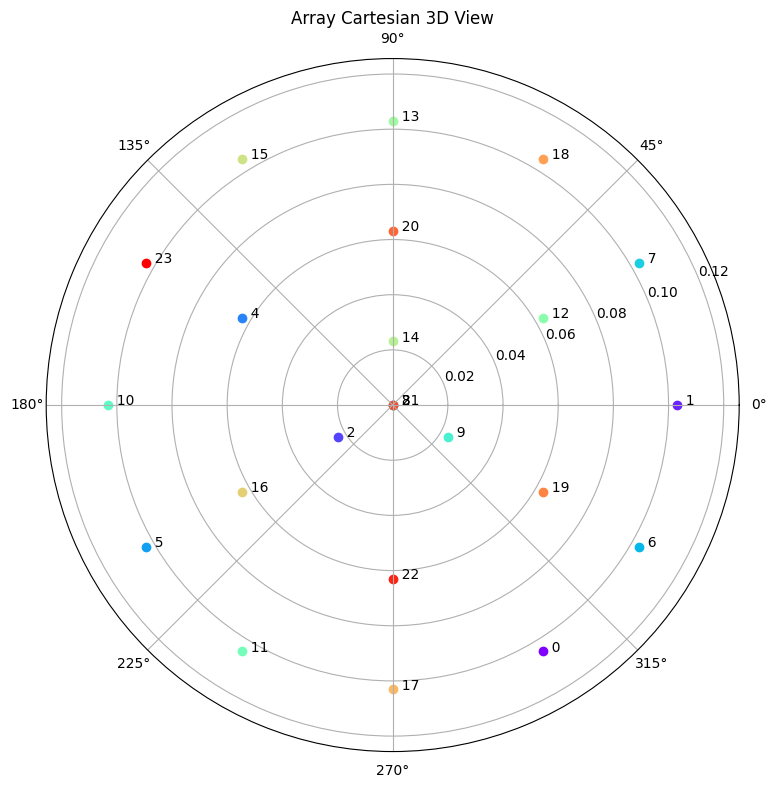

In [64]:
geometry = pd.read_csv('../tools/AA_geometry.tsv', header=None, sep='\t')
AA_Geometry = geometry.to_numpy()
visualizer = Visualizer(AA_Geometry)
visualizer.polar(fig_size=(10,9),save_dir = '../plot/')

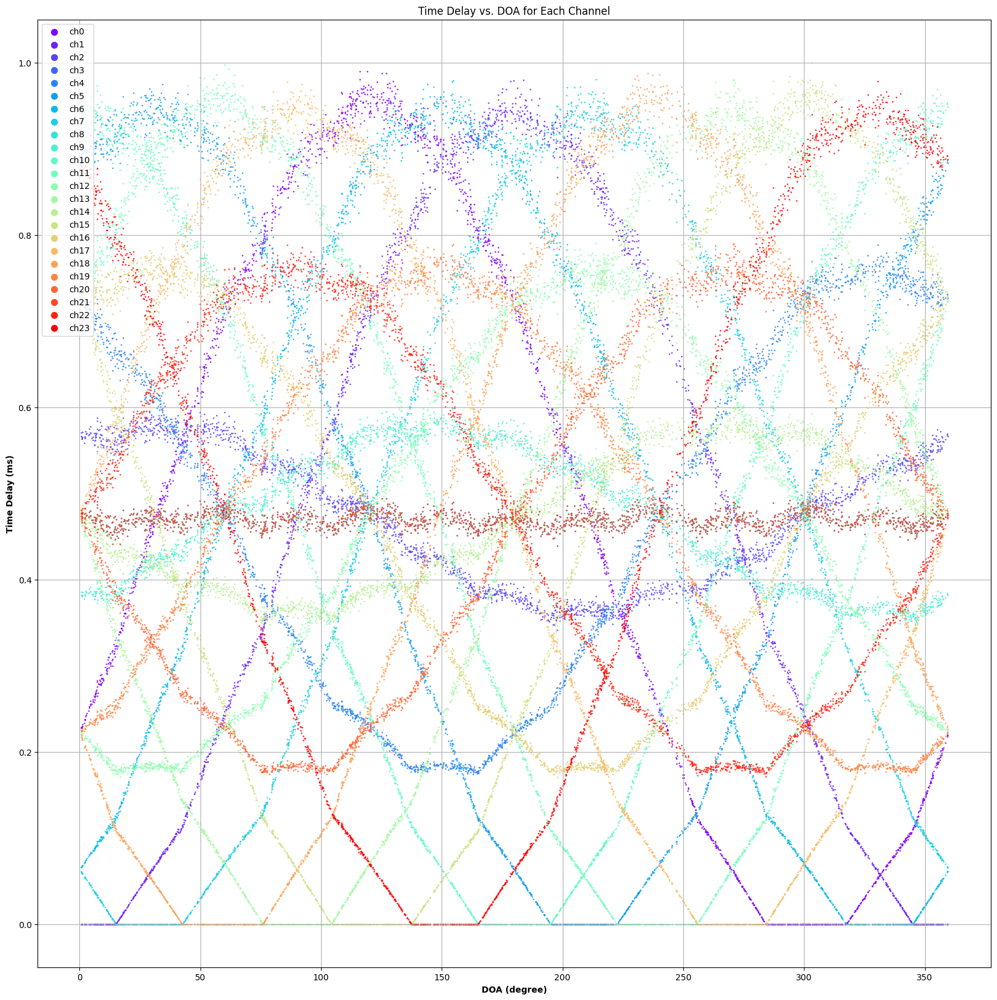

In [272]:
# Extract data from files
data = DataExtract("../data/rss360_noise/", 24)
norm = data.get_norm()
ref_points = data.get_ref()
inputs, speeds, angles = data.get_data()
data.plot()

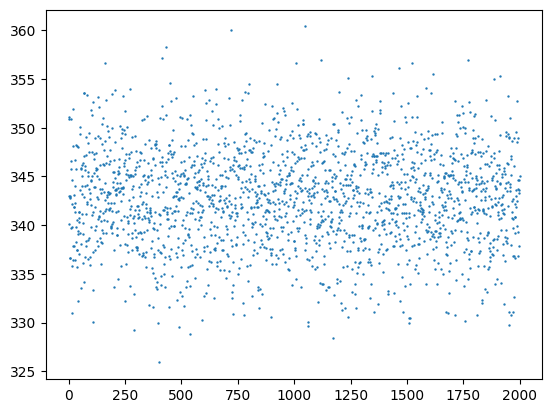

In [270]:
plt.scatter(list(range(len(speeds))),speeds, s=0.5)

In [66]:
df_with_he = pd.read_csv("../plot/models_evaluation_with_weights_initialization.csv")
list_channels = [re.findall(r'\d+',item['Channels']) for i,item in df_with_he.iterrows()]
list_channels = [sorted([int(i) for i in ls]) for ls in list_channels]
list_channels

[[1, 14, 21],
 [12, 14, 20],
 [10, 11, 13],
 [8, 17, 22],
 [6, 11, 20],
 [7, 8, 21],
 [0, 12, 22],
 [8, 11, 13],
 [2, 10, 22],
 [7, 15, 22],
 [8, 16, 23],
 [1, 4, 14],
 [1, 5, 12],
 [7, 8, 11],
 [3, 11, 17],
 [6, 12, 13],
 [3, 7, 10],
 [4, 13, 23],
 [10, 13, 22],
 [4, 9, 15],
 [4, 16, 17],
 [3, 10, 13],
 [3, 10, 13],
 [8, 10, 15],
 [6, 16, 22],
 [15, 19, 21],
 [1, 13, 19],
 [5, 18, 21],
 [3, 4, 21],
 [7, 9, 11],
 [8, 15, 17],
 [0, 7, 18],
 [1, 14, 21],
 [17, 20, 22],
 [5, 13, 14],
 [4, 14, 22],
 [0, 15, 23],
 [5, 15, 23],
 [3, 7, 10],
 [0, 2, 12],
 [2, 10, 19],
 [3, 9, 20],
 [6, 15, 21],
 [3, 12, 20],
 [10, 12, 13],
 [0, 7, 17],
 [10, 11, 18],
 [13, 14, 16],
 [5, 12, 22],
 [15, 19, 23],
 [0, 2, 4, 6, 14, 23],
 [2, 4, 5, 6, 10, 16],
 [1, 5, 6, 15, 16, 22],
 [2, 5, 9, 13, 17, 22],
 [2, 10, 12, 14, 20, 23],
 [5, 6, 7, 13, 19, 23],
 [5, 11, 13, 15, 21, 22],
 [3, 8, 14, 15, 16, 17],
 [10, 14, 16, 17, 20, 21],
 [0, 1, 2, 13, 14, 15],
 [0, 2, 5, 7, 9, 18],
 [2, 3, 9, 10, 11, 15],
 [4, 8, 9, 1

In [67]:
# Get the list of channels with loss less than 55 
# The 75 is a convience number from the results
top_with_he =  df_with_he.index[df_with_he['Loss'] < 55].tolist()
top_list_channels = [list_channels[i] for i in top_with_he]
top_list_channels.append(list(range(0,24)))
top_list_channels

[[6, 12, 13],
 [1, 13, 19],
 [0, 7, 18],
 [3, 12, 20],
 [12, 13, 15, 17, 19, 22],
 [2, 9, 10, 12, 17, 18],
 [2, 7, 9, 13, 19, 20],
 [8, 12, 16, 18, 21, 22],
 [2, 6, 8, 9, 12, 15, 18, 20, 22],
 [0, 2, 4, 8, 9, 12, 18, 19, 22],
 [1, 2, 3, 4, 9, 13, 17, 18, 22],
 [0, 3, 5, 6, 9, 12, 14, 15, 18, 19, 20, 23],
 [2, 3, 4, 6, 8, 10, 12, 13, 14, 15, 17, 18, 19, 22, 23],
 [0, 1, 3, 4, 6, 7, 8, 9, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23],
 [0,
  1,
  2,
  3,
  4,
  5,
  6,
  7,
  8,
  9,
  10,
  11,
  12,
  13,
  14,
  15,
  16,
  17,
  18,
  19,
  20,
  21,
  22,
  23]]

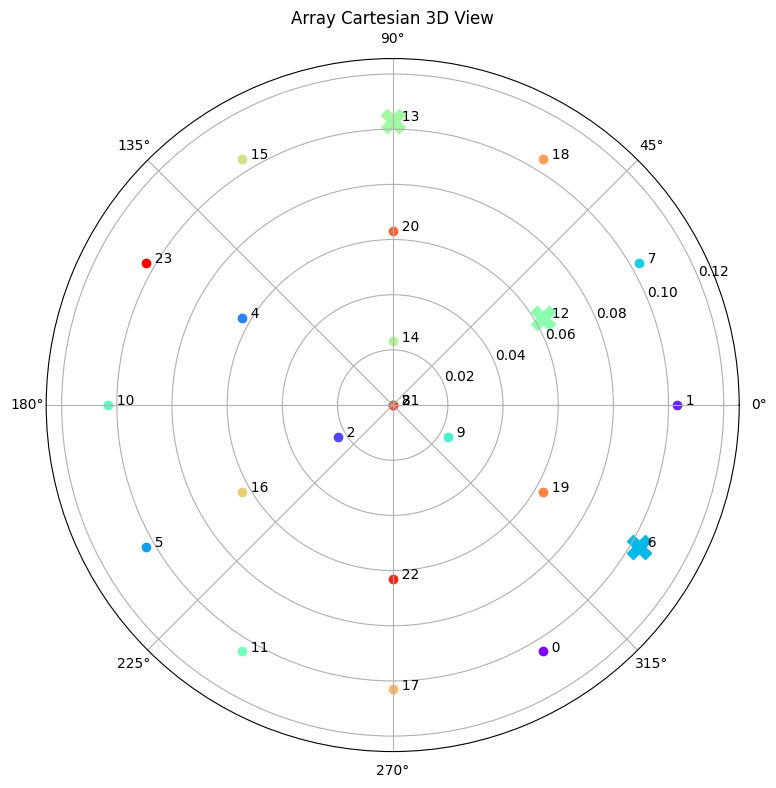

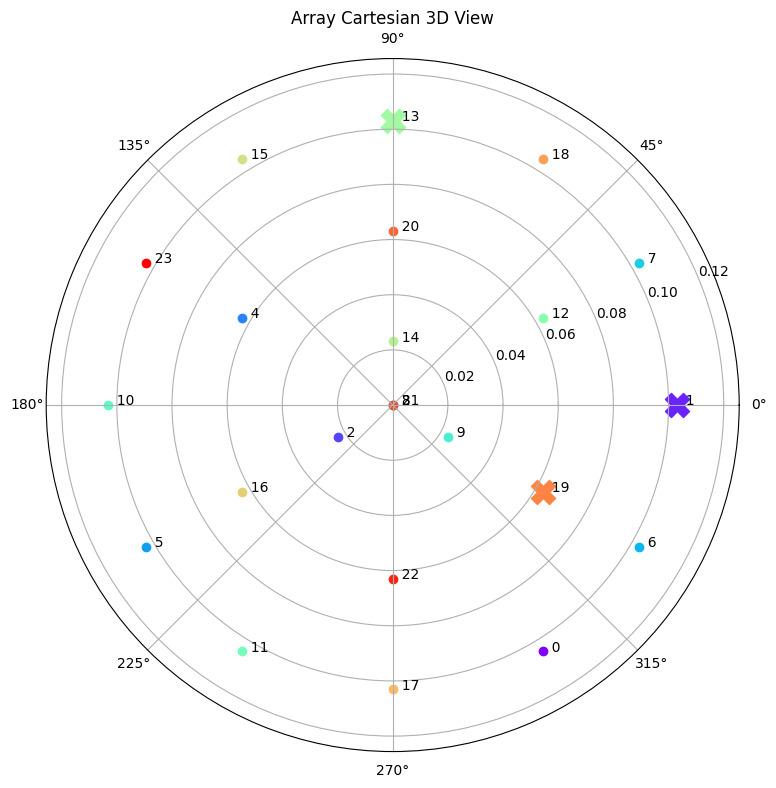

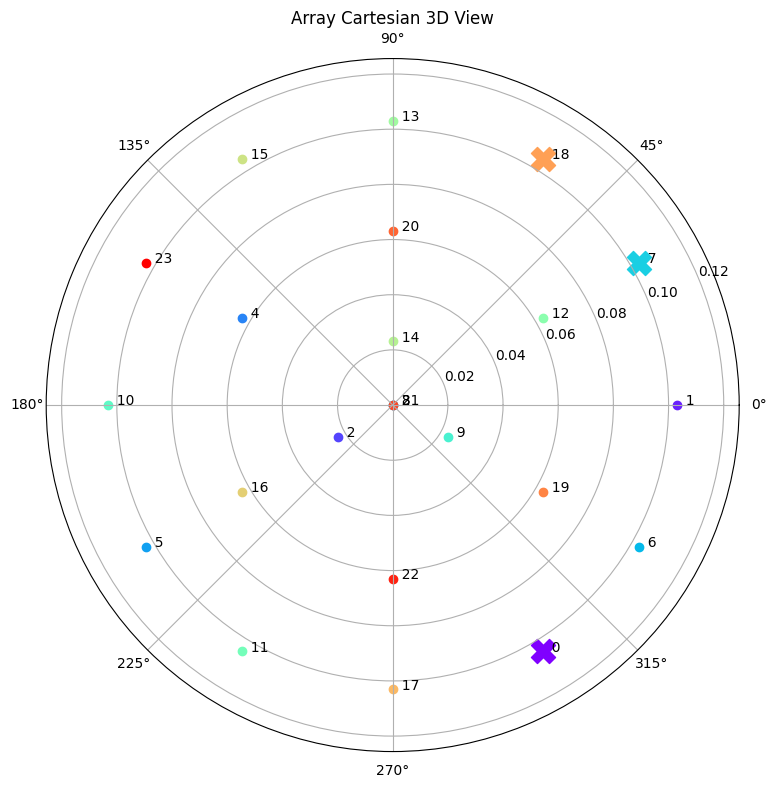

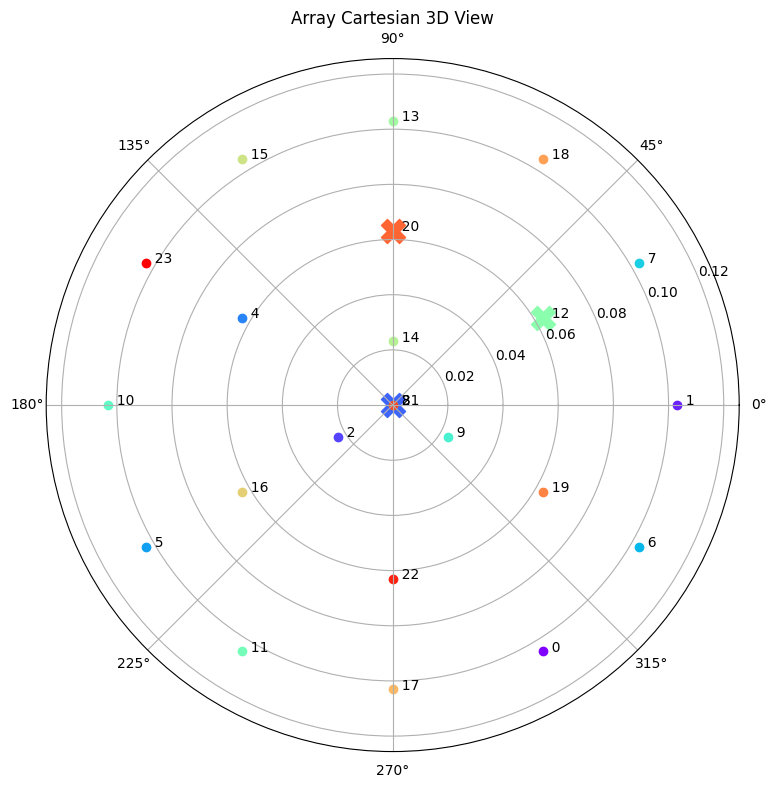

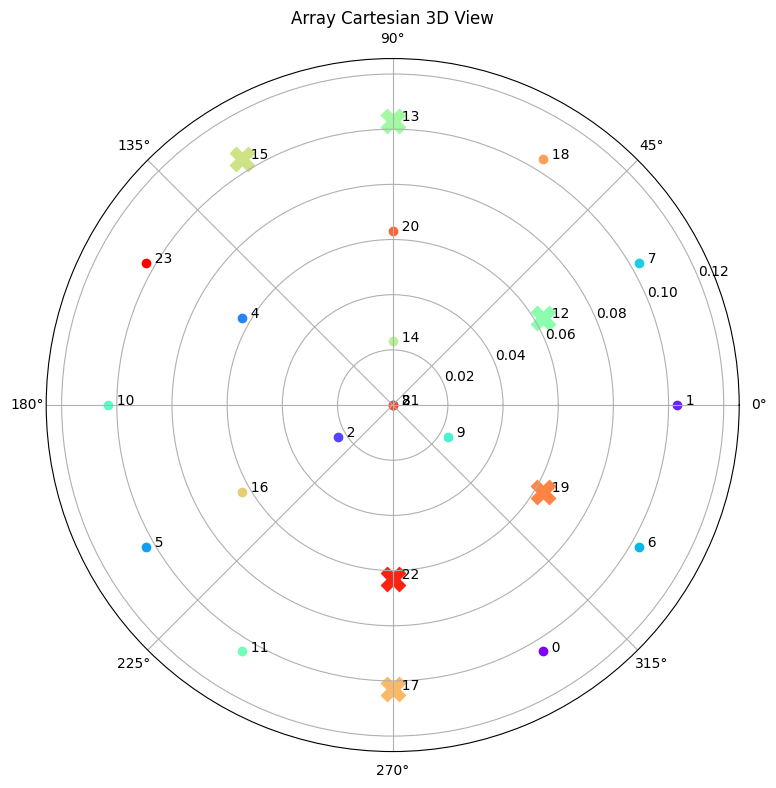

...

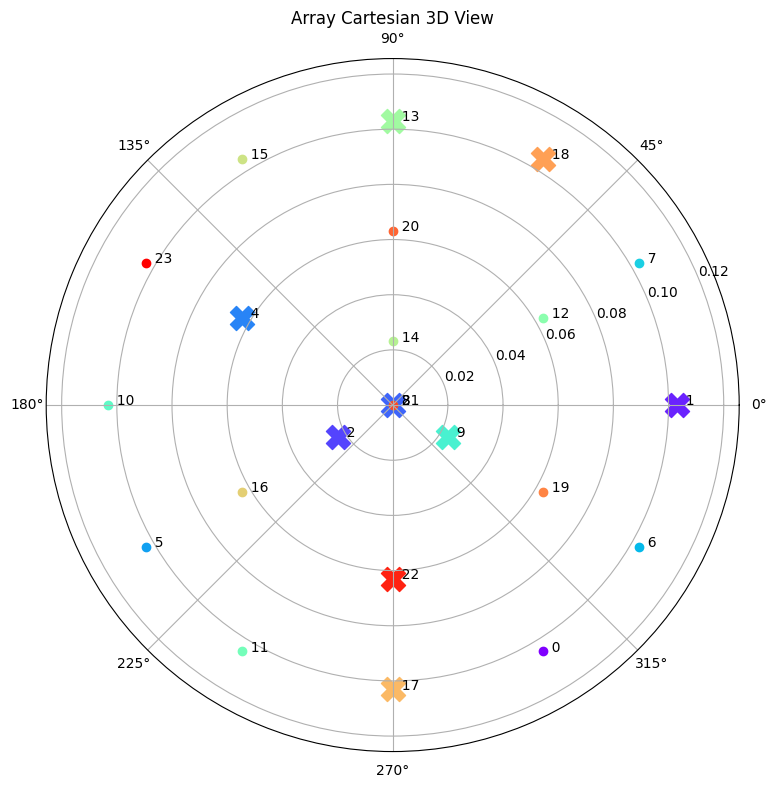

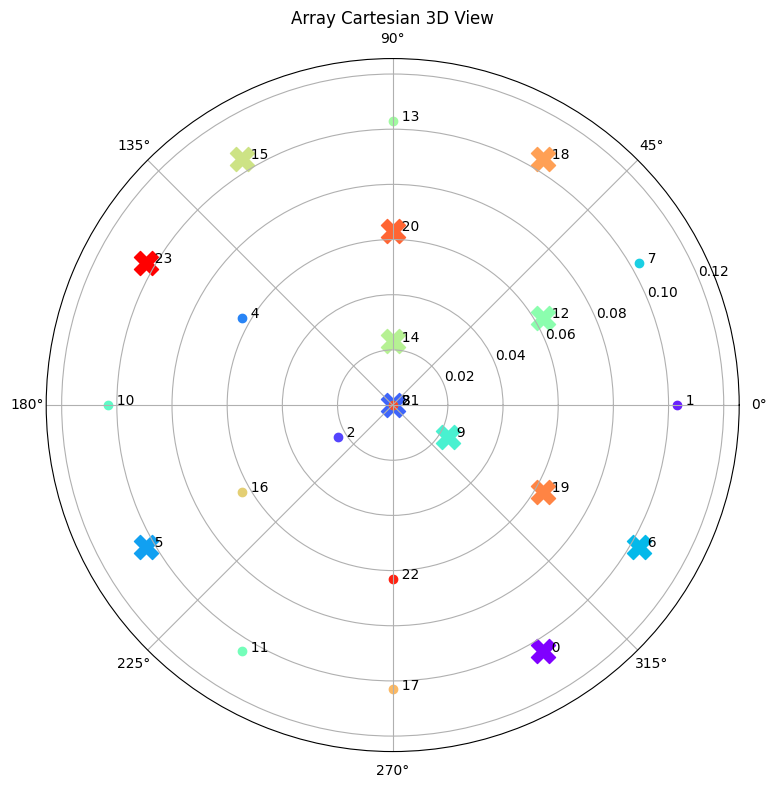

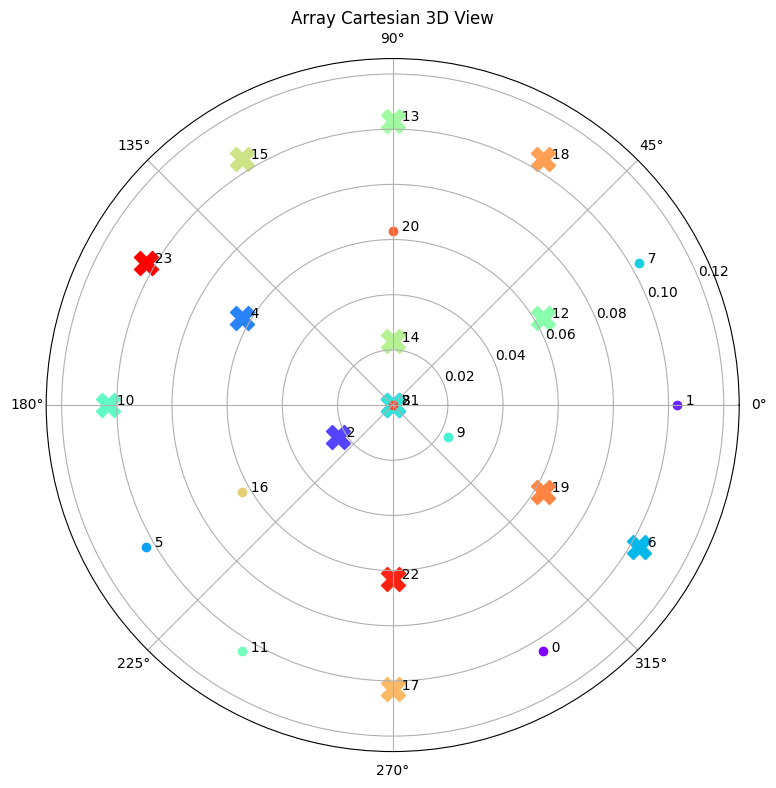

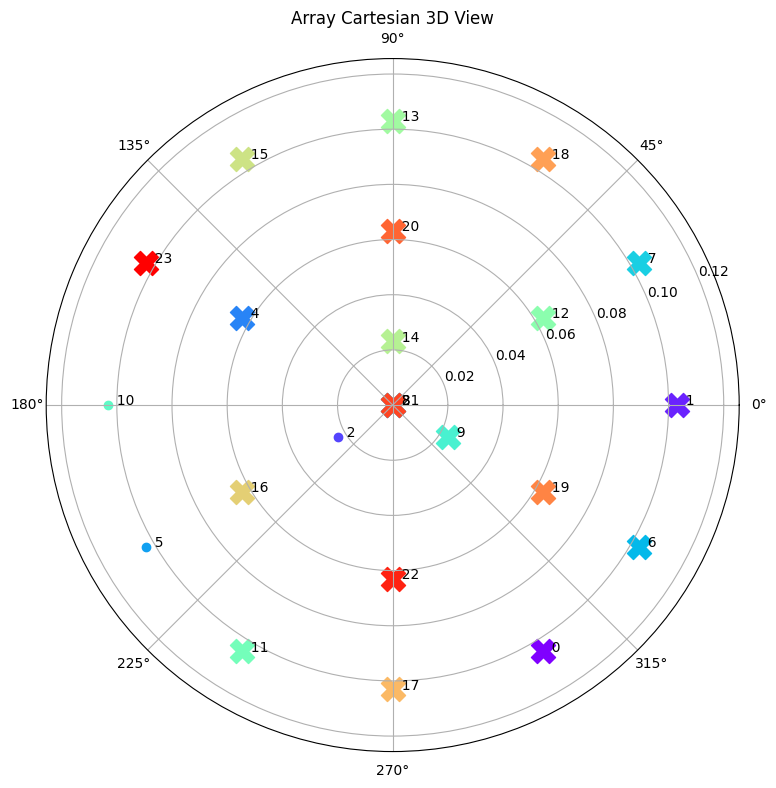

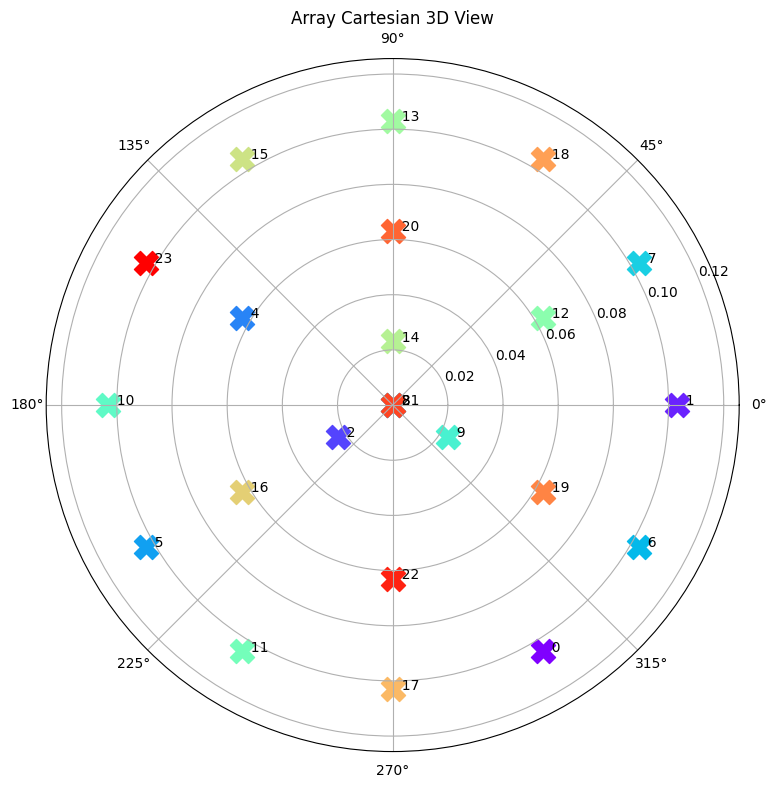

In [222]:
for channels in top_list_channels:
    visualizer.polar(fig_size=(10,9), channels = channels)

Epoch 1/30
TensorShape([2]) TensorShape([2])
 1/44 ━━━━━━━━━━━━━━━━━━━━ 1:20 2s/step - loss: 63676.4961 - mae: 55.4020 - mse: 5705.0381TensorShape([2]) TensorShape([2])
TensorShape([2]) TensorShape([2])
TensorShape([2]) TensorShape([2])
TensorShape([2]) TensorShape([2])
TensorShape([2]) TensorShape([2])
TensorShape([2]) TensorShape([2])
 7/44 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 78744.4609 - mae: 53.7410 - mse: 5522.4102TensorShape([2]) TensorShape([2])
TensorShape([2]) TensorShape([2])
 9/44 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 79262.6406 - mae: 53.4740 - mse: 5492.6548TensorShape([2]) TensorShape([2])
TensorShape([2]) TensorShape([2])
11/44 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 80041.6875 - mae: 53.1736 - mse: 5456.3281TensorShape([2]) TensorShape([2])
TensorShape([2]) TensorShape([2])
13/44 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 80956.1406 - mae: 53.1001 - mse: 5461.1938TensorShape([2]) TensorShape([2])
TensorShape([2]) TensorShape([2])
15/44 ━━━━━━━━━━━━━━━━━━━━ 0s

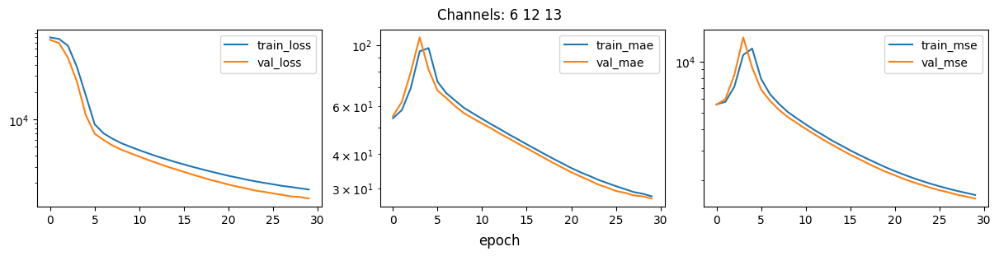

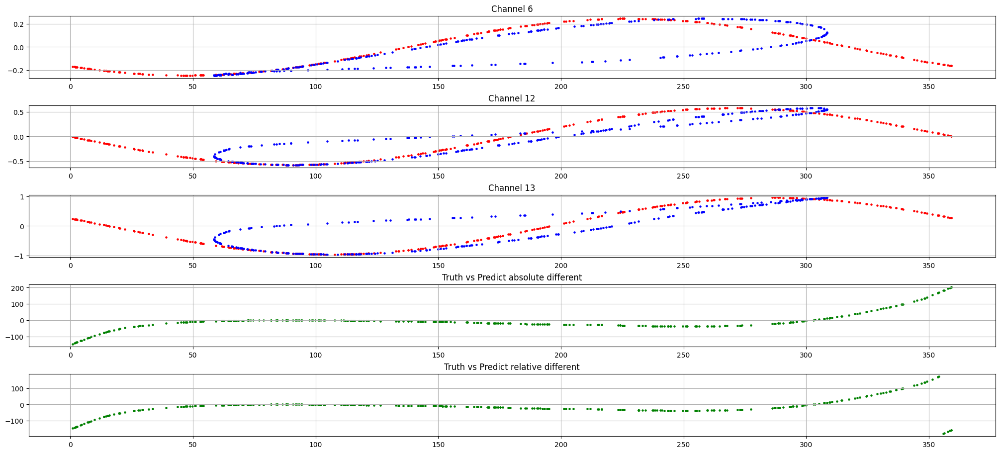

In [258]:
for i in range(1):
    models, evaluates, losses = training_evaluation(top_list_channels[:1], AA_Geometry, inputs, speeds, angles, norm, clambda = [1.0,0.0,1.0],
                                                        he_initializer=True, \
                                                        floormod=True, epochs=30, plot=True, verbose=True)

[0.012586232274770737, 11.095086097717285, 2.408306837081909]
[0.0008387752459384501, 0.7199171781539917, 0.6001187562942505]
[0.08369875699281693, 222.28182983398438, 2.8330142498016357]
[0.024086616933345795, 20.20648193359375, 2.6640255451202393]
[0.01826511137187481, 100.8075942993164, 1.1502599716186523]
[0.03833140805363655, 73.89801788330078, 3.784313917160034]
[0.028582662343978882, 70.43090057373047, 2.522279739379883]
[0.018873244524002075, 55.47170639038086, 1.2942001819610596]
[0.02327488362789154, 62.776771545410156, 1.074529767036438]
[0.020364629104733467, 65.27405548095703, 1.0497279167175293]
[0.01372438669204712, 15.453743934631348, 3.477386951446533]


/tmp/ipykernel_1199037/2017950758.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt .subplots(ncols = 3, nrows=1, figsize=(12,3), layout="constrained")


[0.022132234647870064, 43.33576583862305, 0.7033883333206177]
[0.050369661301374435, 86.70732116699219, 1.8001956939697266]
[0.006862181704491377, 6.475289344787598, 1.3827004432678223]
[0.05111488327383995, 78.90213012695312, 2.6577093601226807]


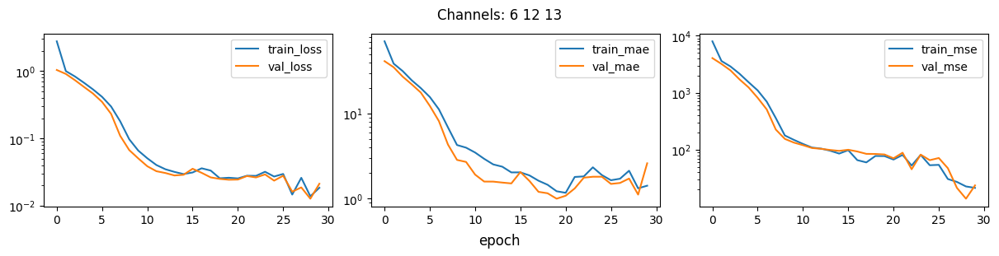

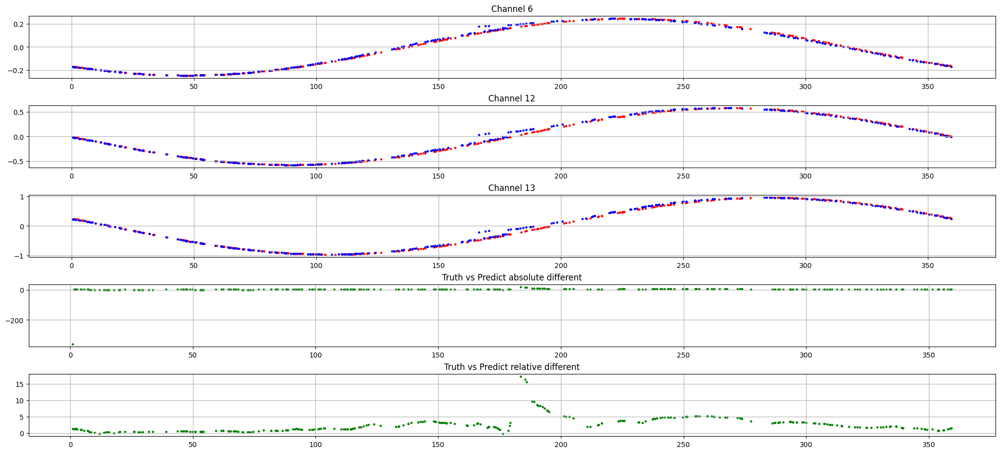

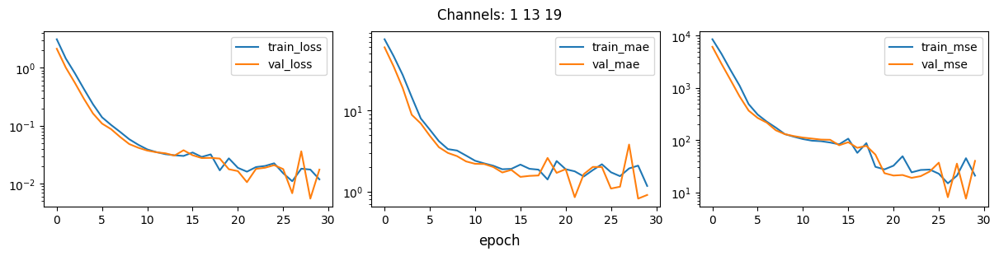

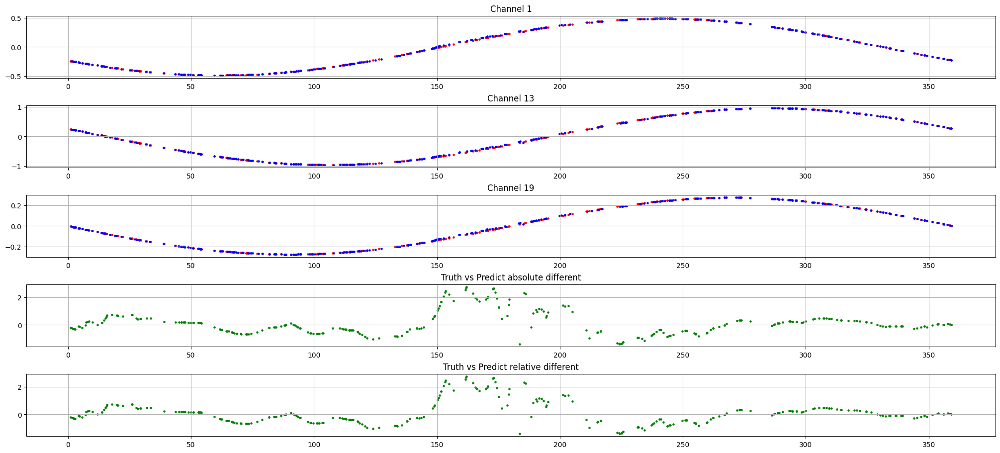

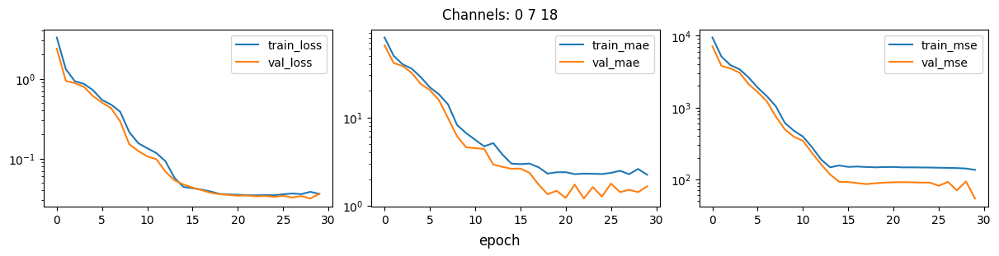

...

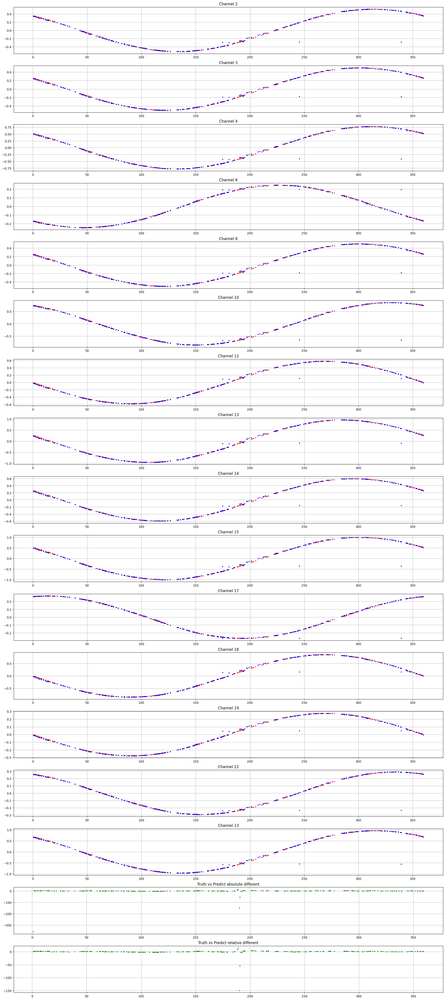

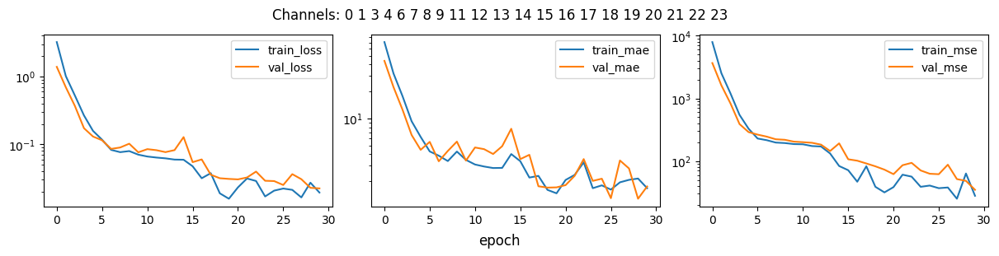

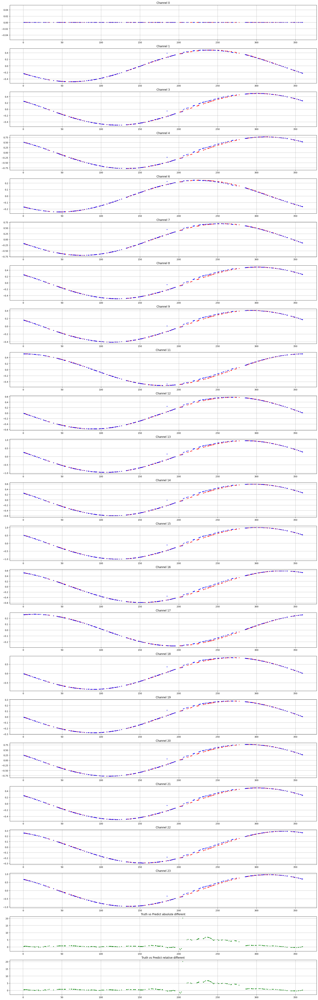

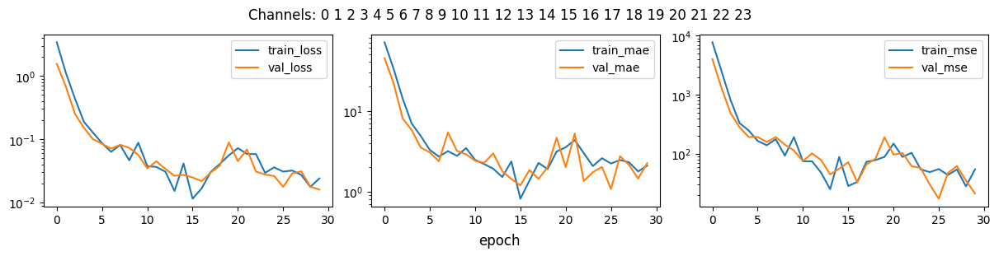

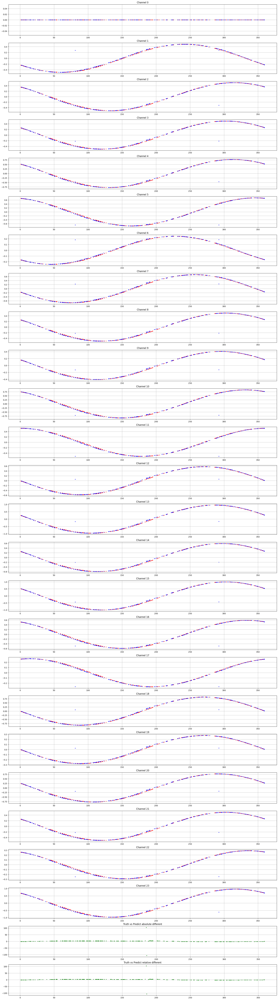

In [187]:
models, evaluates, losses = training_evaluation(top_list_channels, AA_Geometry, inputs, speeds,\
                                                    angles, norm, clambda = [1.0,10.0], \
                                                    he_initializer=True, \
                                                    floormod=True, epochs=30, plot=True)

[0.0010463290382176638, 3.440586805343628, 1.1281559467315674]
[0.0015867408365011215, 5.211621284484863, 1.9879570007324219]
[0.002185256453230977, 7.177485466003418, 2.2957980632781982]
[0.0002161699958378449, 0.7098199725151062, 0.5837098956108093]
[6.9826164690312e-05, 0.22926747798919678, 0.2748337686061859]
[0.012209717184305191, 55.30792236328125, 2.2470805644989014]
[0.011170342564582825, 55.86945343017578, 1.3218841552734375]
[0.0060402266681194305, 22.129491806030273, 1.1897159814834595]
[0.011189824901521206, 57.60794448852539, 1.0338879823684692]
[0.001685751136392355, 5.542852401733398, 1.6111570596694946]
[0.005231233313679695, 18.772274017333984, 1.5087378025054932]


/tmp/ipykernel_1199037/2017950758.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt .subplots(ncols = 3, nrows=1, figsize=(12,3), layout="constrained")


[0.00461937440559268, 15.701623916625977, 1.5788445472717285]
[0.00046014258987270296, 1.5107927322387695, 0.8424590229988098]
[0.0008462065015919507, 2.7790396213531494, 1.1755192279815674]
[0.002709205960854888, 8.947827339172363, 1.6274902820587158]


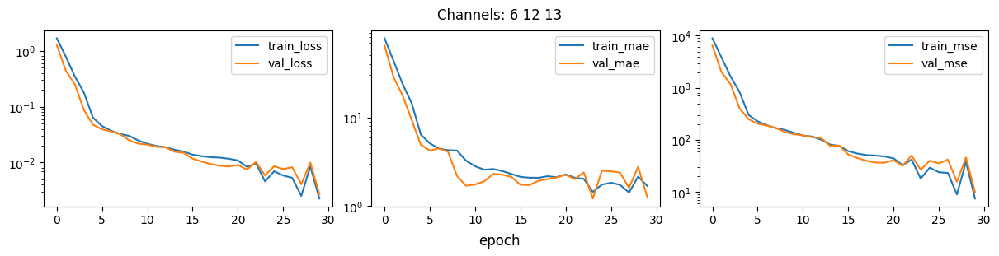

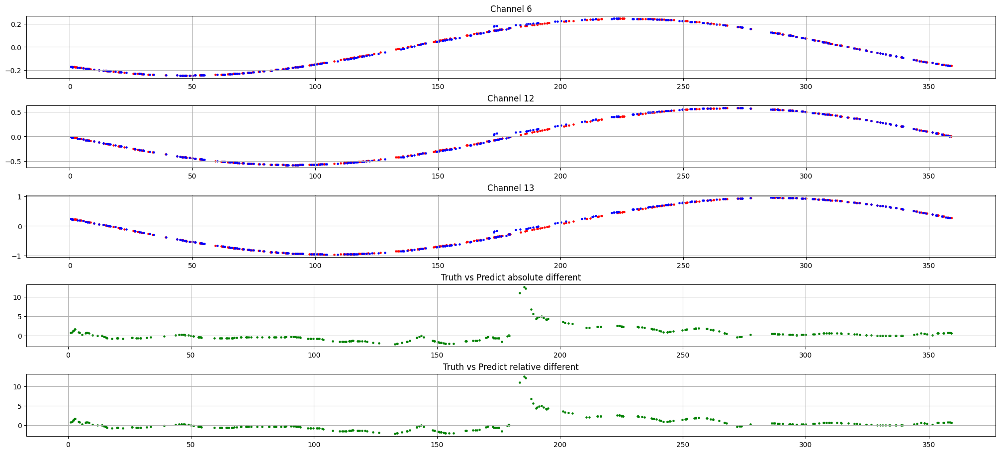

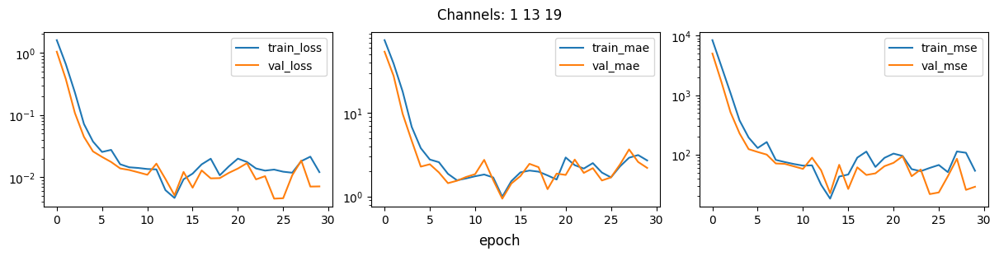

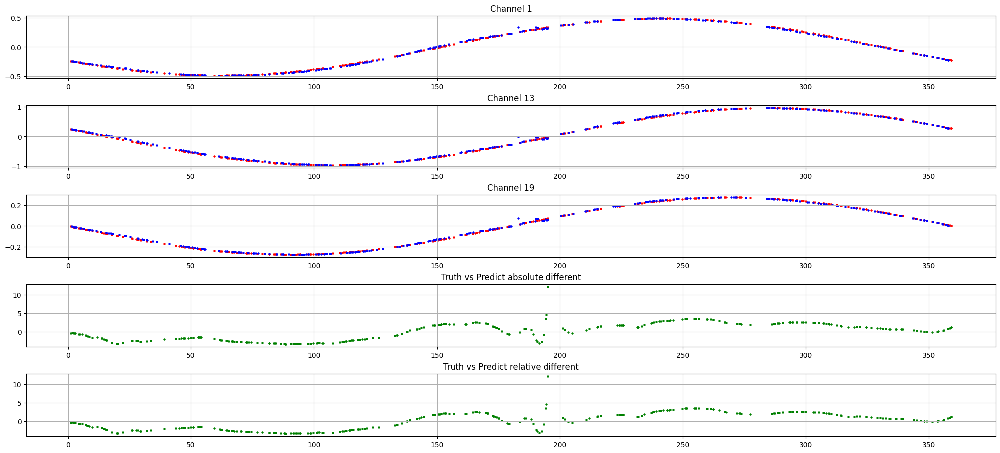

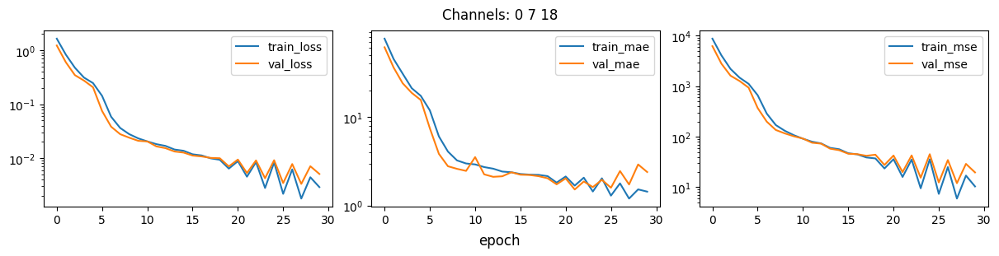

...

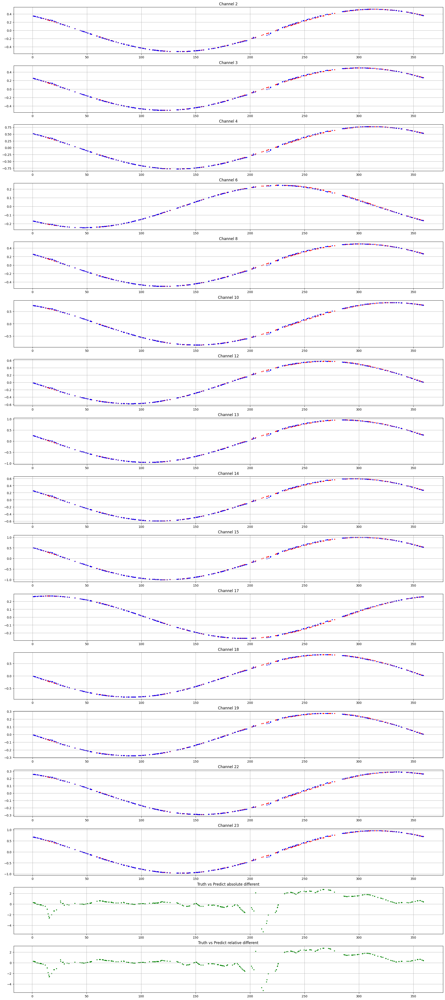

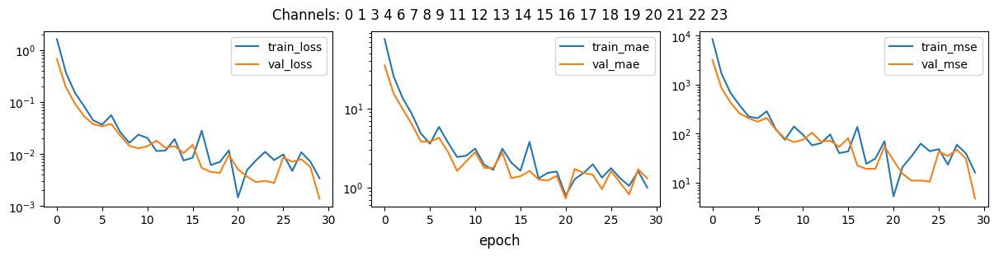

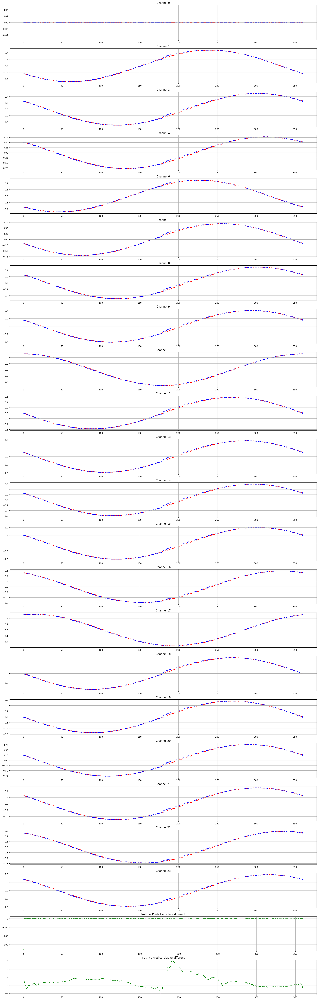

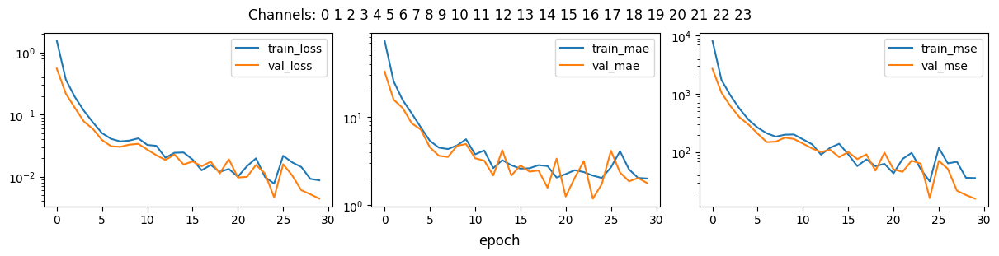

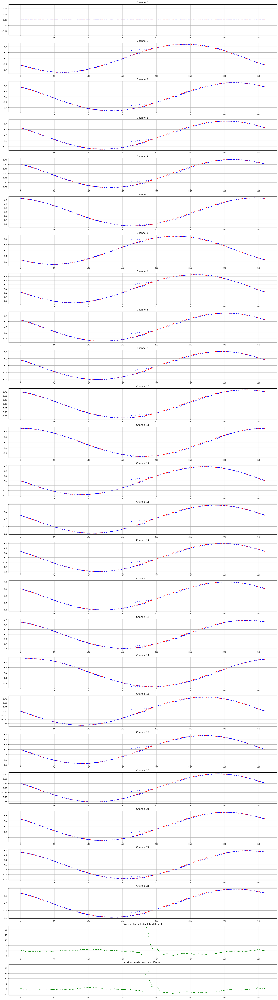

In [188]:
models, evaluates, losses = training_evaluation(top_list_channels, AA_Geometry, inputs, speeds,\
                                                    angles, norm, clambda = [1.0,0.0], \
                                                    he_initializer=True, \
                                                    floormod=True, epochs=30, plot=True)

[0.0012055040569975972, 3.1654021739959717, 1.177978277206421]
[0.013467184267938137, 60.5168571472168, 1.5907763242721558]
[0.0006742079276591539, 1.6738977432250977, 1.0017430782318115]
[0.014641615562140942, 76.31172180175781, 1.729369044303894]
[0.0026174953673034906, 6.706921100616455, 1.2421653270721436]
[0.02415408007800579, 82.45899963378906, 3.9630813598632812]
[0.0029270199593156576, 7.235459804534912, 1.4161094427108765]
[0.01907084695994854, 86.7557373046875, 3.503995418548584]
[0.022402562201023102, 93.13349151611328, 1.7911714315414429]
[0.001957233063876629, 5.477641582489014, 1.5450295209884644]
[0.0051533374935388565, 13.410758018493652, 2.3367576599121094]


/tmp/ipykernel_1199037/2017950758.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt .subplots(ncols = 3, nrows=1, figsize=(12,3), layout="constrained")


[0.005657465662807226, 15.124131202697754, 2.500516653060913]
[0.013659165240824223, 82.32254028320312, 1.0488859415054321]
[0.0016427910886704922, 4.52950382232666, 1.8102238178253174]
[0.00020954776846338063, 0.5380746722221375, 0.4102374315261841]


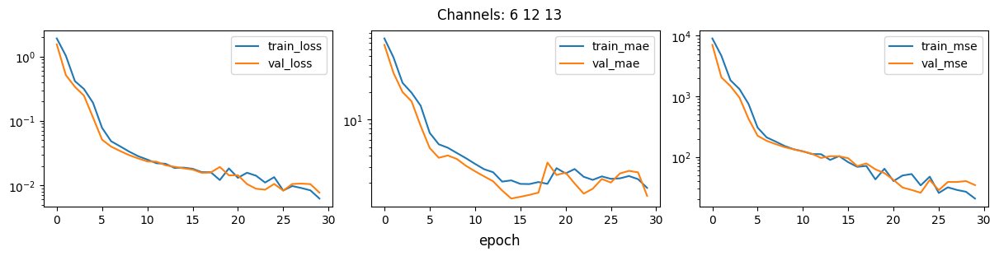

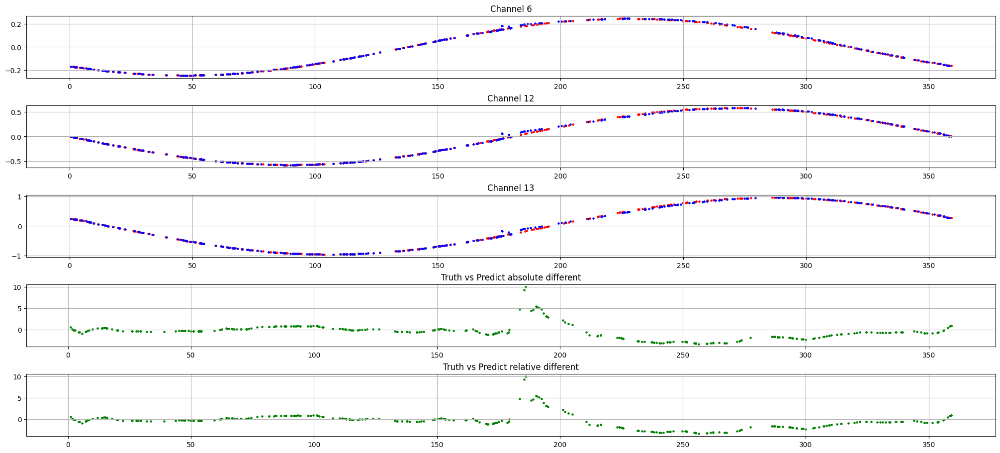

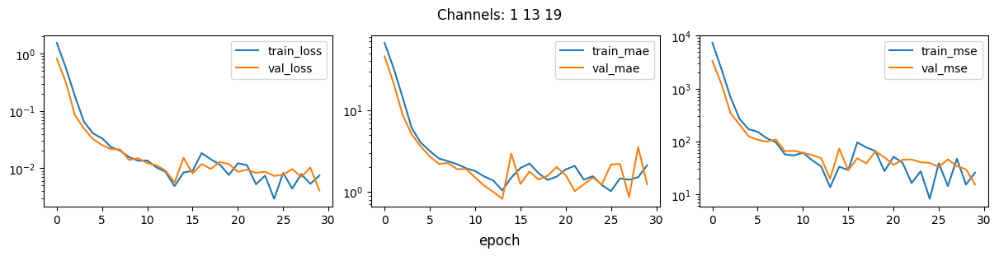

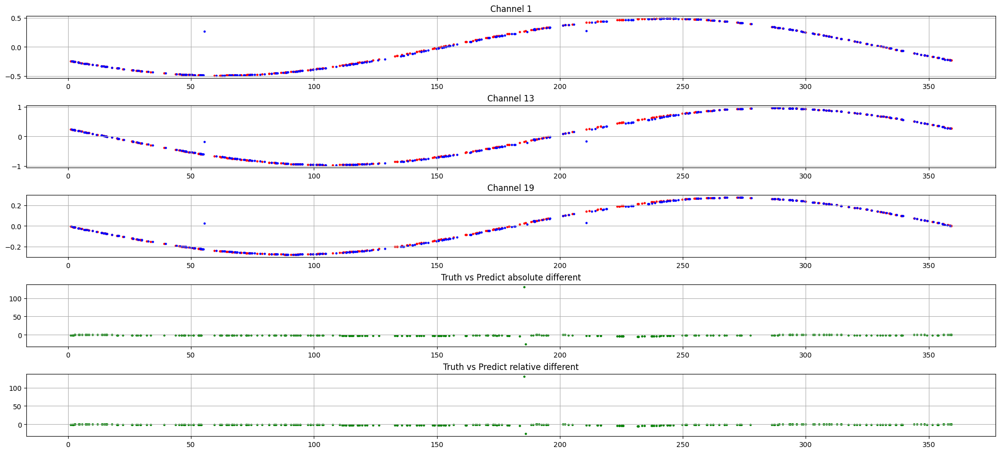

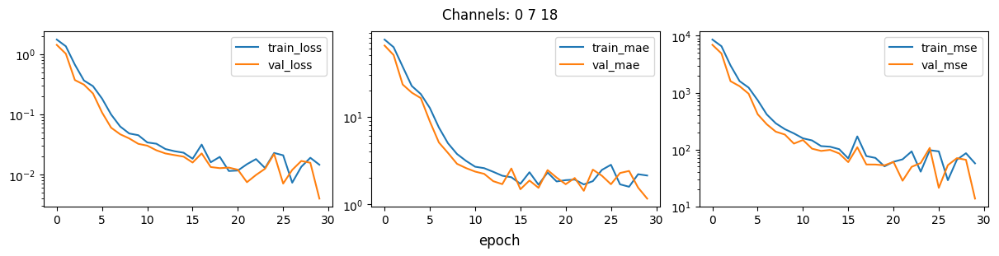

...

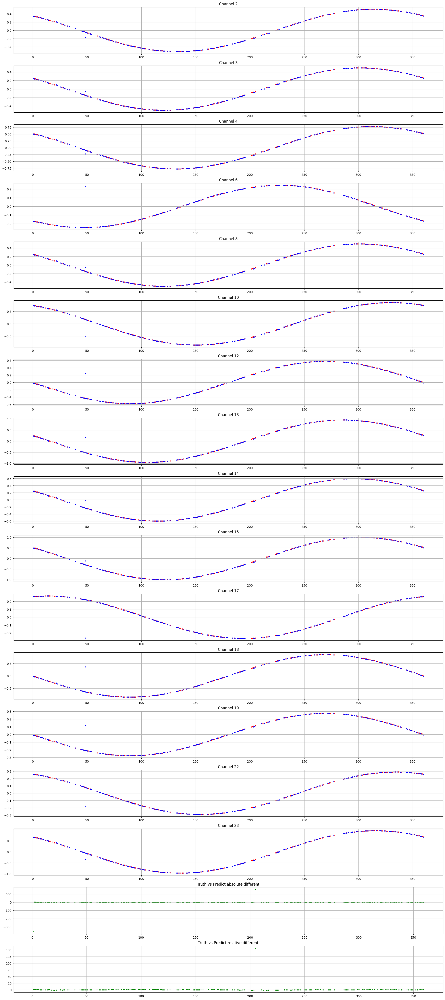

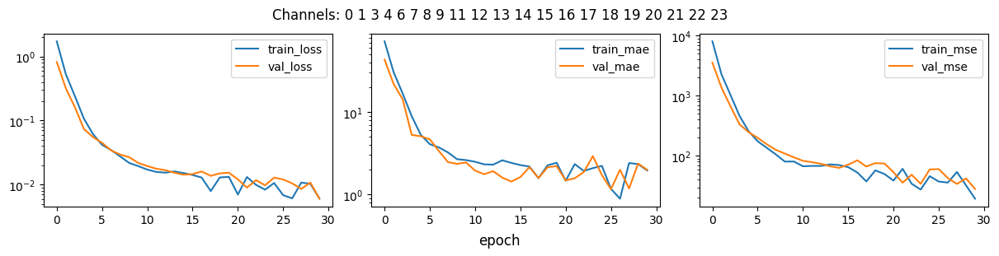

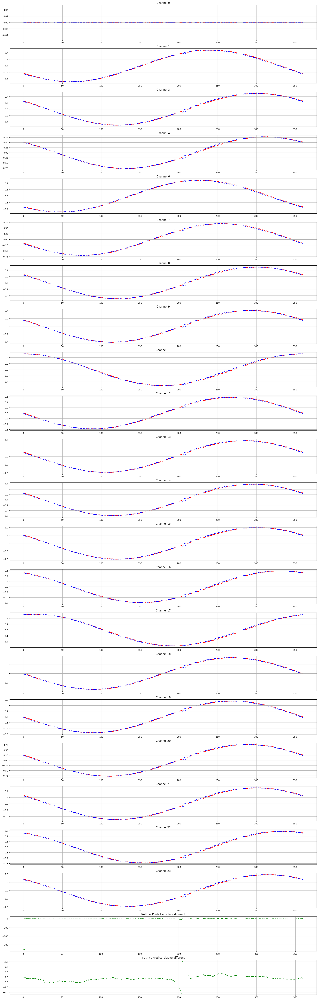

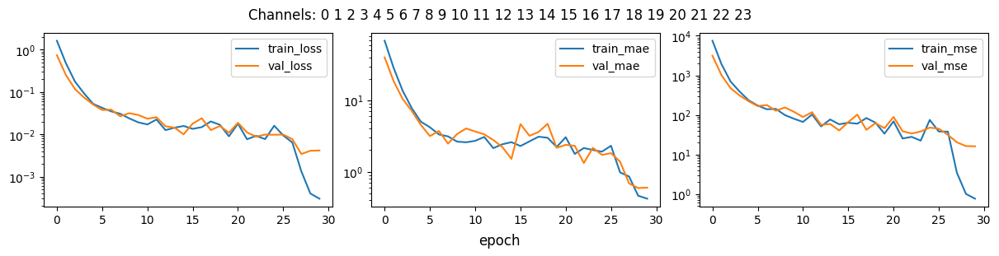

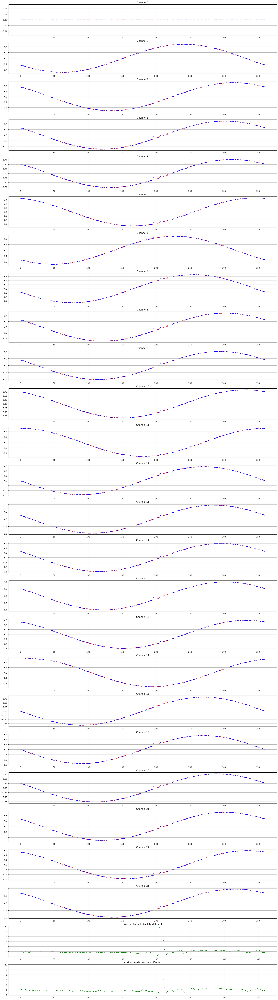

In [189]:
models, evaluates, losses = training_evaluation(top_list_channels, AA_Geometry, inputs, speeds, angles, norm,
                                                    he_initializer=True, \
                                                    floormod=True, epochs=30, plot=True)